In [ ]:
# Autor:        Asier Ortiz García
# Repositorio:  https://github.com/asier-ortiz/ai-course-notebooks/blob/main/actividad5_asier_ortiz.ipynb

# Ejercicio A - Problema de ajuste y cálculo de los pesos en una RNC

Considerad la estructura de una red neuronal convolucional compuesta por cinco capas convolucionales:

- Las dos primeras capas utilizan filtros de **3x3** con un **stride de 2**.
- Las tres siguientes capas utilizan un detector de rasgos de **5x5**.
- La primera capa genera **100 mapas de características**, la segunda **200**, la tercera **300**, la cuarta **400** y la última **500**.
- Las imágenes de entrada son **RGB (3 canales) de 128x128 píxeles**.

**Preguntas:**
1. ¿Cuál sería el número total de parámetros que tendríamos que estimar en esta red?
2. Explicar brevemente el procedimiento de una capa de convolución y su utilidad.

## 1 - Cálculo de parámetros

Fórmula para calcular el número total de parámetros de la red:

$((\text{alto} \times \text{ancho} \times \text{canales}) + 1) \times \text{filtros}$

In [ ]:
# Desglose de los parámetros:

  # ~> alto y ancho son el tamaño del filtro. Normalmente 3x3, 5x5, 7x7 etc... (Se pueden usar otros tamaños dependiendo del problema)
  # ~> canales: número de canales de entrada (3 en la primera capa ya que se trata de imágenes RGB. Para escala de grises sería 1 canal, 4 para RGBA etc...)
  # ~> +1 por el sesgo, un valor extra que se suma a la salida de cada filtro

# Cálculo capa a capa:

  # Capa 1: ((3×3×3) + 1) × 100 = 28 × 100 = 2_800
  # Capa 2: ((3×3×100) + 1) × 200 = 901 × 200 = 180_200
  # Capa 3: ((5×5×200) + 1) × 300 = 5001 × 300 = 1_500_300
  # Capa 4: ((5×5×300) + 1) × 400 = 7501 × 400 = 3_000_400
  # Capa 5: ((5×5×400) + 1) × 500 = 10001 × 500 = 5_000_500

  # Total: 2_800 + 180_200 + 1_500_300 + 3_000_400 + 5_000_500 = 9_684_200

## 2 - Explicación de una capa convolucional

In [ ]:
# Una capa convolucional aplica varios filtros que recorren la imagen buscando patrones visuales, como bordes, formas o texturas.
# Cada filtro genera una especie de "mapa" que indica dónde aparece ese patrón en la imagen.
# Gracias a esto, la red puede aprender a reconocer características importantes sin necesidad de analizar cada píxel por separado.
# Este tipo de capas usa muchos menos parámetros que las capas densas, lo que hace que el modelo sea también más eficiente

# Ejmplo con Keras:

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Conv2D

model = Sequential()

# Indico el tamaño de las imágenes de entrada (128x128 RGB)
model.add(Input(shape=(128, 128, 3)))

# Capas 1 y 2 con filtros 3x3 y un stride 2
model.add(Conv2D(filters=100, kernel_size=(3, 3), strides=(2, 2), activation='relu'))
model.add(Conv2D(filters=200, kernel_size=(3, 3), strides=(2, 2), activation='relu'))

# Capas de la 3 a la 5 con filtros 5x5
model.add(Conv2D(filters=300, kernel_size=(5, 5), activation='relu'))
model.add(Conv2D(filters=400, kernel_size=(5, 5), activation='relu'))
model.add(Conv2D(filters=500, kernel_size=(5, 5), activation='relu'))

# Muestro el resumen del modelo
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)                    │ (None, 63, 63, 100)         │           2,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 31, 31, 200)         │         180,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 27, 27, 300)         │       1,500,300 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 23, 23, 400)         │       3,000,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 19, 19, 500)         │       5,000,500 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 9,684,200 (36.94 MB)

 Trainable params: 9,684,200 (36.94 MB)

 Non-trainable params: 0 (0.00 B)

# Ejercicio B. Problema de clasificación de imágenes satelitáles

En este ejercicio tendréis que tomar como punto de partida el caso visto en el Notebook *'02_Introducción a las RNC en TensorFlow 2.0'*.  Partiendo del mismo conjunto de datos de imágenes de EUROSAT *(dataset)*, el objetivo será proponer, al menos, tres arquitecturas de redes neuronales de convolución para los siguientes casos y comparad su precisión realizando las siguientes validaciones simples (no utilizar validación cruzada):

- **Escenario 1:** Entrenamiento 1000 imágenes y Testing 200 imágenes.
- **Escenario 2:** Entrenamiento 5000 imágenes y Testing 1000 imágenes.

Tened en cuenta que tendréis que crear nuevos directorios incluyendo una muestra de las imágenes contenidas en el archivo de datos inicial. Por supuesto, tiene que estar balanceado, es decir, mismo número de observaciones para cada una de las 10 clases consideradas.

Recordad que las fases básicas para implementar dicho algoritmo de aprendizaje profundo son las siguientes:

1. Preprocesado datos entrada red neuronal de convolución.
2. Definición de la arquitectura red neuronal de convolución.
3. Configuración del proceso de aprendizaje de la RNC.
4. Entrenamiento del modelo de red neuronal de convolución.
5. Evaluación del modelo de red neuronal de convolución.

In [ ]:
#################################################################################################################################################

# Tutorial sobre clasificación de imágenes con Keras
    # Ref. https://keras.io/examples/vision/image_classification_from_scratch/
    # Ref. https://www.youtube.com/watch?v=dFdMyUbtKM4
    # Ref. https://keras.io/api/applications/xception/

# Documentación Keras
  # Ref. https://keras.io/api/callbacks/early_stopping/
  # Ref. https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ReduceLROnPlateau

# Ejemplo de cómo plotear una curva de aprendizaje
    # Ref. https://scikit-learn.org/stable/auto_examples/model_selection/plot_learning_curve.html

# Recursos sobre CNNs
    # Ref. https://medium.com/@hassaanidrees7/vision-transformer-vs-cnn-a-comparison-of-two-image-processing-giants-d6c85296f34f
    # Ref. https://www.reddit.com/r/computervision/comments/1cu3pnw/cnn_vs_vision_transformer_a_practitioners_guide/?tl=es-es
    # Ref. https://docs.kanaries.net/es/topics/ChatGPT/convnext
    # Ref. https://www.toolify.ai/es/ai-news-es/descubre-el-fascinante-mundo-del-swin-transformer-552304
    # Ref. https://www.geeksforgeeks.org/vision-transformers-vs-convolutional-neural-networks-cnns/
    # Ref. https://flypix.ai/blog/image-recognition-models-cnns/
    # Ref. https://stackoverflow.com/questions/79128531/problems-running-convnext-models-from-tensorflow-keras-applications-on-my-macboo

# Ejemplo de cómo tratar imágenes corruptas
    # https://drlee.io/identifying-corrupted-images-before-feeding-them-into-a-cnn-13397844ef3c

# Ejemplo de uso de flow_from_dataframe
  # Ref. https://vijayabhaskar96.medium.com/tutorial-on-keras-flow-from-dataframe-1fd4493d237c

#################################################################################################################################################

In [ ]:
# Importación de librerías y configuraiones

import cv2
import kagglehub
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import random
import seaborn as sns
import shutil
import tensorflow as tf
from collections import Counter
from google.colab import drive
from pathlib import Path
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay,
    roc_auc_score
)
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.layers import Conv2D, Dense, Dropout, Flatten, MaxPooling2D
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

## 1 - Conexión a Google Drive y descarga del dataset desde Kaggle

In [ ]:
# Monto Google Drive
print("Conectando con Google Drive...")
drive.mount('/content/drive')

# Rutas para el Drive
drive_dataset_path = "/content/drive/MyDrive/EuroSAT"
kaggle_download_path = "/root/.cache/kagglehub/datasets/apollo2506/eurosat-dataset/versions/6/EuroSAT"

# Verifico si ya existe el dataset en el Drive
if not os.path.exists(drive_dataset_path):
    print("\n Dataset no encontrado en Drive. Descargando desde Kaggle...")
    # Lo descargo si no existe
    full_download_path = kagglehub.dataset_download("apollo2506/eurosat-dataset")
    # Muevo la carpeta de EuroSAT desde la caché al Drive
    shutil.copytree(kaggle_download_path, drive_dataset_path)
    print(f" Dataset movido a Drive: {drive_dataset_path}")
else:
    print(f" Dataset disponible en: {drive_dataset_path}")

# Ruta base del dataset
DATA_DIR = drive_dataset_path

Conectando con Google Drive...
Mounted at /content/drive

 Dataset no encontrado en Drive. Descargando desde Kaggle...


100%|██████████| 2.04G/2.04G [00:15<00:00, 142MB/s]

Extracting files...


 Dataset movido a Drive: /content/drive/MyDrive/EuroSAT


## 2 - Preparación de los conjuntos balanceados para ambos escenarios

### 2.1 -Generación de carpetas y CSVs por escenario

In [ ]:
# El enunciado pide crear carpetas nuevas con una muestra balanceada por clase,
# así que no uso directamente el CSV original. En su lugar, genero dos escenarios
# (scenario1 y scenario2) con el mismo número de imágenes por clase y los copio
# en carpetas separadas por split y clase

# Cargo los CSVs desde el Drive
train_df = pd.read_csv(f"{DATA_DIR}/train.csv")
val_df = pd.read_csv(f"{DATA_DIR}/validation.csv")
test_df = pd.read_csv(f"{DATA_DIR}/test.csv")
all_df = pd.concat([train_df, val_df, test_df], axis=0)

# Ruta con las imágenes originales
source_images_path = Path(DATA_DIR)

# Ruta de salida Nota: Si ya existe se borra y se vuelve a crear
target_base = Path("/content/eurosat_balanced")
if target_base.exists():
    shutil.rmtree(target_base)
target_base.mkdir(parents=True, exist_ok=True)

# Escenarios
scenarios = {
    "scenario1": {"train": 100, "test": 20},
    "scenario2": {"train": 500, "test": 100},
}

# Preparo los datos por escenario
for scenario, sizes in scenarios.items():
    print(f"\n Preparando {scenario.upper()}...")

    # Creo las carpetas base para el escenario (train y test)
    scenario_dir = target_base / scenario
    (scenario_dir / "train").mkdir(parents=True, exist_ok=True)
    (scenario_dir / "test").mkdir(parents=True, exist_ok=True)

    # Aquí voy guardando los datos que luego irán a los CSVs
    train_list = []
    test_list = []

    # Recorro cada clase del dataset
    for cls in sorted(all_df["ClassName"].unique()):

        # Selecciono aleatoriamente imágenes de esta clase (train + test)
        class_images = all_df[all_df["ClassName"] == cls].sample(
            n=sizes["train"] + sizes["test"], random_state=42
        )

        # Divido las imágenes entre train y test
        train_imgs = class_images.iloc[:sizes["train"]].copy()
        test_imgs = class_images.iloc[sizes["train"]:].copy()

        # Añado una columna con el split para luego crear los CSVs
        train_imgs["Split"] = "train"
        test_imgs["Split"] = "test"

        # Las guardo en sus listas correspondientes
        train_list.append(train_imgs)
        test_list.append(test_imgs)

        # Creo las carpetas por clase dentro de train y test
        (scenario_dir / "train" / cls).mkdir(parents=True, exist_ok=True)
        (scenario_dir / "test" / cls).mkdir(parents=True, exist_ok=True)

        # Copio las imágenes de train a su carpeta correspondiente
        for _, row in train_imgs.iterrows():
            src = source_images_path / row["Filename"]
            dst = scenario_dir / "train" / row["ClassName"] / os.path.basename(row["Filename"])
            shutil.copy(src, dst)

        # Lo mismo para test
        for _, row in test_imgs.iterrows():
            src = source_images_path / row["Filename"]
            dst = scenario_dir / "test" / row["ClassName"] / os.path.basename(row["Filename"])
            shutil.copy(src, dst)

    # Guardo los CSVs con las rutas e info de cada split
    pd.concat(train_list).to_csv(scenario_dir / "train.csv", index=False)
    pd.concat(test_list).to_csv(scenario_dir / "test.csv", index=False)

    print(f" {scenario.upper()} listo: {sizes['train']} train + {sizes['test']} test por clase.")


 Preparando SCENARIO1...
 SCENARIO1 listo: 100 train + 20 test por clase.

 Preparando SCENARIO2...
 SCENARIO2 listo: 500 train + 100 test por clase.


### 2.2 - Visualización de la estructura de carpetas generadas

In [ ]:
# Instalo tree y muestro la estructura de carpetas generadas
!apt-get install tree
!tree /content/eurosat_balanced -L 3

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 29 not upgraded.
Need to get 47.9 kB of archives.
After this operation, 116 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tree amd64 2.0.2-1 [47.9 kB]
Fetched 47.9 kB in 0s (126 kB/s)
Selecting previously unselected package tree.
(Reading database ... 126209 files and directories currently installed.)
Preparing to unpack .../tree_2.0.2-1_amd64.deb ...
Unpacking tree (2.0.2-1) ...
Setting up tree (2.0.2-1) ...
Processing triggers for man-db (2.10.2-1) ...
/content/eurosat_balanced
├── scenario1
│   ├── test
│   │   ├── AnnualCrop
│   │   ├── Forest
│   │   ├── HerbaceousVegetation
│   │   ├── Highway
│   │   ├── Industrial
│   │   ├── Pasture
│   │   ├── PermanentCrop
│   │   ├── Residential
│   │   ├── River
│   │   └── SeaLake
│   ├── t

### 2.3 - Visualización de muestras aleatorias por clase y escenario

In [ ]:
def plot_samples():
    """
    Muestra una imagen aleatoria por clase para cada conjunto (train/test)
    de ambos escenarios.
    """

    # Defino los escenarios a mostrar (nombre que se muestra, ruta del escenario, split)
    scenarios = [
        ("Escenario 1 - Train", "scenario1", "train"),
        ("Escenario 1 - Test", "scenario1", "test"),
        ("Escenario 2 - Train", "scenario2", "train"),
        ("Escenario 2 - Test", "scenario2", "test"),
    ]

    # Obtengo los nombres de las clases desde la carpeta del escenario 1
    class_dir = Path("/content/eurosat_balanced/scenario1/train")
    class_names = sorted(os.listdir(class_dir))
    num_classes = len(class_names)

    # Creo la figura. Una fila por split, una columna por clase
    fig, axes = plt.subplots(len(scenarios) + 1, num_classes + 1, figsize=(24, 12))

    # Ajusto el espacio entre subplots
    plt.subplots_adjust(left=0.01, right=0.99, top=0.92, bottom=0.03, wspace=0.05, hspace=0.05)

    # Etiquetas de las columnas
    for col in range(1, num_classes + 1):
        axes[0, col].axis("off")
        axes[0, col].text(
            0.5, 0.35,
            class_names[col - 1],
            fontsize=12, ha='center', va='bottom', wrap=True
        )

    # Etiquetas de las filas
    for row_idx, (label, scenario, split) in enumerate(scenarios, start=1):
        axes[row_idx, 0].axis("off")
        axes[row_idx, 0].text(
            0.5, 0.5,
            label,
            fontsize=13, ha='center', va='center',
            rotation=90, wrap=True
        )

        # Recorro cada clase y muestro una imagen random de su carpeta
        base_folder = Path(f"/content/eurosat_balanced/{scenario}/{split}")
        for col_idx, class_name in enumerate(class_names, start=1):
            class_folder = base_folder / class_name
            images = list(class_folder.glob("*.jpg"))

            if not images:
                axes[row_idx, col_idx].axis("off")
                continue

            img_path = random.choice(images)
            img = mpimg.imread(img_path)

            axes[row_idx, col_idx].imshow(img)
            axes[row_idx, col_idx].axis("off")

    # Quito la esquina superior izquierda para que quede vacía
    axes[0, 0].axis("off")

    # Título
    fig.suptitle("Muestra aleatoria por clase en cada subconjunto", fontsize=40, y=0.97)

    plt.show()

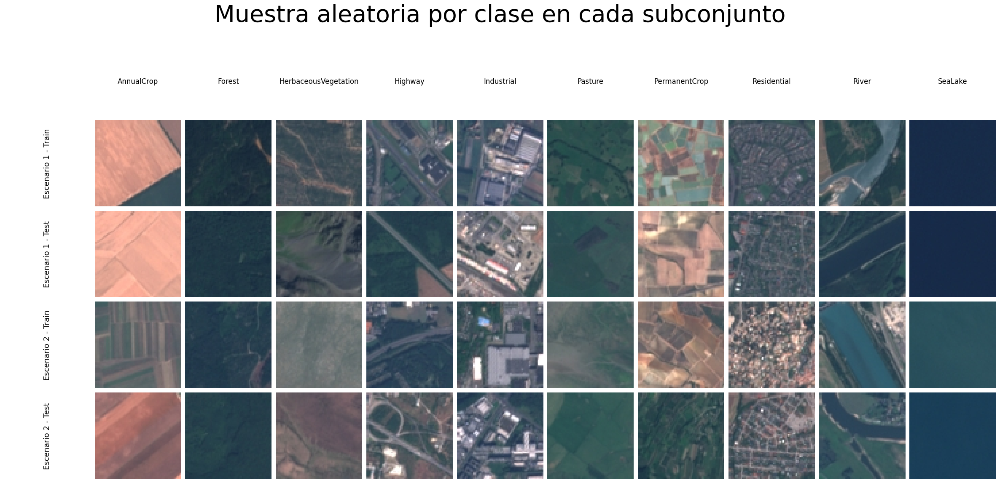

In [ ]:
plot_samples()

## 3 - Carga de datos en TensorFlow

In [ ]:
# En lugar de hacer los splits a mano uso generadores con flow_from_dataframe porque
# ya tengo los CSVs listos y las carpetas organizadas y así no cargo todo en memoria.
# Además me da más control sobre el tamaño de imagen, del batch, el shuffle, etc...

IMG_SIZE = 64
BATCH_SIZE = 32
SEED = 42

# Instancio el generador
datagen = ImageDataGenerator(rescale=1./255)

def create_generators(csv_path, image_dir, shuffle=True):
    # Leo el CSV con las rutas y etiquetas
    df = pd.read_csv(csv_path)

    # Creo el generador a partir del dataframe
    generator = datagen.flow_from_dataframe(
        dataframe=df,
        directory=image_dir,
        x_col="Filename",
        y_col="ClassName",
        target_size=(IMG_SIZE, IMG_SIZE),
        batch_size=BATCH_SIZE,
        class_mode="categorical", # Para onehot encoding automático
        shuffle=shuffle,
        seed=SEED
    )
    return generator

# Escenario 1
train_gen_1 = create_generators(
    "/content/eurosat_balanced/scenario1/train.csv",
    "/content/eurosat_balanced/scenario1/train"
)

test_gen_1 = create_generators(
    "/content/eurosat_balanced/scenario1/test.csv",
    "/content/eurosat_balanced/scenario1/test",
    shuffle=False  # para evaluación es mejor que no mezcle
)

# Escenario 2
train_gen_2 = create_generators(
    "/content/eurosat_balanced/scenario2/train.csv",
    "/content/eurosat_balanced/scenario2/train"
)

test_gen_2 = create_generators(
    "/content/eurosat_balanced/scenario2/test.csv",
    "/content/eurosat_balanced/scenario2/test",
    shuffle=False
)

# Almaceno los nombres de las clases que usaré posteriormente
class_names = list(train_gen_1.class_indices.keys())

Found 1000 validated image filenames belonging to 10 classes.
Found 200 validated image filenames belonging to 10 classes.
Found 5000 validated image filenames belonging to 10 classes.
Found 1000 validated image filenames belonging to 10 classes.


## 4 - Definición y entrenamiento de modelos CNN

### 4.1 - Definicion de modelos y configuración

In [ ]:
NUM_CLASSES = 10  # Total de clases del dataset

# Modelo 1
def create_model_1(optimizer='adam'):
    model = Sequential([
        tf.keras.Input(shape=(64, 64, 3)),
        Conv2D(32, (3, 3), activation='relu'),
        MaxPooling2D(2, 2),
        Flatten(),
        Dense(64, activation='relu'),
        Dense(NUM_CLASSES, activation='softmax')
    ])
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Modelo 2
def create_model_2(optimizer='adam'):
    model = Sequential([
        tf.keras.Input(shape=(64, 64, 3)),
        Conv2D(32, (3, 3), activation='relu'),
        MaxPooling2D(2, 2),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPooling2D(2, 2),
        Flatten(),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(NUM_CLASSES, activation='softmax')
    ])
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Modelo 3
def create_model_3(optimizer='adam'):
    model = Sequential([

        # Capa de entrada
        tf.keras.Input(shape=(64, 64, 3)),

        # Primera capa convolucional
        Conv2D(32, (3, 3), activation='relu'),

        # Primera capa de MaxPooling
        MaxPooling2D(2, 2),

        # Segunda capa convolucional
        Conv2D(64, (3, 3), activation='relu'),

        # Segunda capa de MaxPooling
        MaxPooling2D(2, 2),

        # Tercera capa convolucional
        Conv2D(128, (3, 3), activation='relu'),

        # Tercera capa de MaxPooling
        MaxPooling2D(2, 2),

        # Capa Flatten
        Flatten(),

        # Capa Dense
        Dense(256, activation='relu'),

        # Capa Dropout
        Dropout(0.5),

        # Capa Dense de salida:
        Dense(NUM_CLASSES, activation='softmax')
    ])

    # Compilación del modelo
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    return model

In [ ]:
EPOCHS = 100
BATCH_SIZE = 32

# Callbacks

# Detiene entrenamiento si la validación no mejora tras X épocas (parámetro patience)
early_stop = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

# Reduce el learning rate si la validación no mejora tras X épocas (parámetro patience)
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5, # Reduce a la mitad el lr
    patience=5,
    min_lr=1e-6, # Límite inferior al learning rate ~> 0.000001
    verbose=1
)

# Diccionario para guardar modelos e historiales
history_dict = {
    "scenario1": {},
    "scenario2": {}
}

### 4.2 - Entrenamiento de modelos por escenario

#### 4.2.1 - Escenario 1

In [ ]:
# Entrenamiento para el escenario 1

models_1 = {
    "Modelo 1": create_model_1(optimizer=Adam(learning_rate=0.001)),
    "Modelo 2": create_model_2(optimizer=Adam(learning_rate=0.001)),
    "Modelo 3": create_model_3(optimizer=Adam(learning_rate=0.001))
}

# TODO Entrenar cada uno en celdas separadas en el lugar de todo en bucle
for name, model in models_1.items():
    print(f"\n Entrenando {name}...")
    history = model.fit(
        train_gen_1,
        validation_data=test_gen_1,
        epochs=EPOCHS,
        callbacks=[early_stop, reduce_lr],
        verbose=1
    )
    history_dict["scenario1"][name] = (model, history)


 Entrenando Modelo 1...
Epoch 1/100
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 59ms/step - accuracy: 0.1475 - loss: 2.7760 - val_accuracy: 0.2700 - val_loss: 2.0574 - learning_rate: 0.0010
Epoch 2/100
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.2612 - loss: 1.9693 - val_accuracy: 0.2850 - val_loss: 1.8741 - learning_rate: 0.0010
Epoch 3/100
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.3575 - loss: 1.7526 - val_accuracy: 0.3450 - val_loss: 1.7331 - learning_rate: 0.0010
Epoch 4/100
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4413 - loss: 1.6135 - val_accuracy: 0.4500 - val_loss: 1.6490 - learning_rate: 0.0010
Epoch 5/100
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4916 - loss: 1.4809 - val_accuracy: 0.4350 - val_loss: 1.5573 - learning_rate: 0.0010
Epoch 6/100
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5278 - loss: 1.3837 - val_accuracy: 0.4200 - val_loss: 1.5384 - learning_rate: 0.0010
Epoch 7/100
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy:

#### 4.2.2 - Escenario 2

In [ ]:
# Entrenamiento para el escenario 2

models_2 = {
    "Modelo 1": create_model_1(optimizer=Adam(learning_rate=0.001)),
    "Modelo 2": create_model_2(optimizer=Adam(learning_rate=0.001)),
    "Modelo 3": create_model_3(optimizer=Adam(learning_rate=0.001))
}

for name, model in models_2.items():
    print(f"\n Entrenando {name}...")
    history = model.fit(
        train_gen_2,
        validation_data=test_gen_2,
        epochs=EPOCHS,
        callbacks=[early_stop, reduce_lr],
        verbose=1
    )
    history_dict["scenario2"][name] = (model, history)


 Entrenando Modelo 1...
Epoch 1/100
157/157 ━━━━━━━━━━━━━━━━━━━━ 5s 23ms/step - accuracy: 0.2101 - loss: 2.2205 - val_accuracy: 0.3950 - val_loss: 1.5549 - learning_rate: 0.0010
Epoch 2/100
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.4552 - loss: 1.4277 - val_accuracy: 0.5270 - val_loss: 1.2478 - learning_rate: 0.0010
Epoch 3/100
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.5597 - loss: 1.1888 - val_accuracy: 0.5550 - val_loss: 1.1822 - learning_rate: 0.0010
Epoch 4/100
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.6425 - loss: 1.0176 - val_accuracy: 0.5950 - val_loss: 1.0912 - learning_rate: 0.0010
Epoch 5/100
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.6601 - loss: 0.9779 - val_accuracy: 0.6010 - val_loss: 1.0677 - learning_rate: 0.0010
Epoch 6/100
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.6827 - loss: 0.8935 - val_accuracy: 0.5910 - val_loss: 1.0846 - learning_rate: 0.0010
Epoch 7/100
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/st

## 5 - Evaluación de modelos y métricas

In [ ]:
def evaluate_model(model, generator, scenario, model_name):
    """
    Evalúa el modelo y muestra las métricas (Classification Report, ROC-AUC y Matriz de Confusión)
    """

    # Obtengo las predicciones del modelo
    y_pred_probs = model.predict(generator, verbose=0)

    # Extraigo las etiquetas verdaderas del generador (una por batch)
    y_true = np.concatenate([generator[i][1] for i in range(len(generator))])

    # Paso de onehot a etiquetas numéricas
    y_true_labels = np.argmax(y_true, axis=1)
    y_pred_labels = np.argmax(y_pred_probs, axis=1)

    # Classification Report
    print(f"\n Classification Report - {model_name} ({scenario})")
    print(classification_report(
        y_true_labels,
        y_pred_labels,
        target_names=class_names,
        zero_division=0
    ))

    # ROC-AUC en modo one-vs-rest
    try:
        roc_auc = roc_auc_score(y_true, y_pred_probs, multi_class="ovr")
        print(f"ROC-AUC (OVR): {roc_auc:.4f}")
    except Exception as e:
        print(f"No se pudo calcular ROC-AUC: {e}")

    # Matriz de confusión
    cm = confusion_matrix(y_true_labels, y_pred_labels)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="YlGnBu", xticklabels=class_names, yticklabels=class_names)
    plt.title(f"Matriz de Confusión - {model_name} ({scenario})")
    plt.xlabel("Predicción")
    plt.ylabel("Real")
    plt.xticks(rotation=45, ha="right")
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()


 Classification Report - Modelo 1 (scenario1)
                      precision    recall  f1-score   support

          AnnualCrop       0.79      0.55      0.65        20
              Forest       0.76      0.95      0.84        20
HerbaceousVegetation       0.38      0.55      0.45        20
             Highway       0.64      0.35      0.45        20
          Industrial       0.56      0.50      0.53        20
             Pasture       0.67      0.60      0.63        20
       PermanentCrop       0.47      0.45      0.46        20
         Residential       0.58      0.70      0.64        20
               River       0.53      0.50      0.51        20
             SeaLake       0.78      0.90      0.84        20

            accuracy                           0.60       200
           macro avg       0.61      0.61      0.60       200
        weighted avg       0.61      0.60      0.60       200

ROC-AUC (OVR): 0.9162


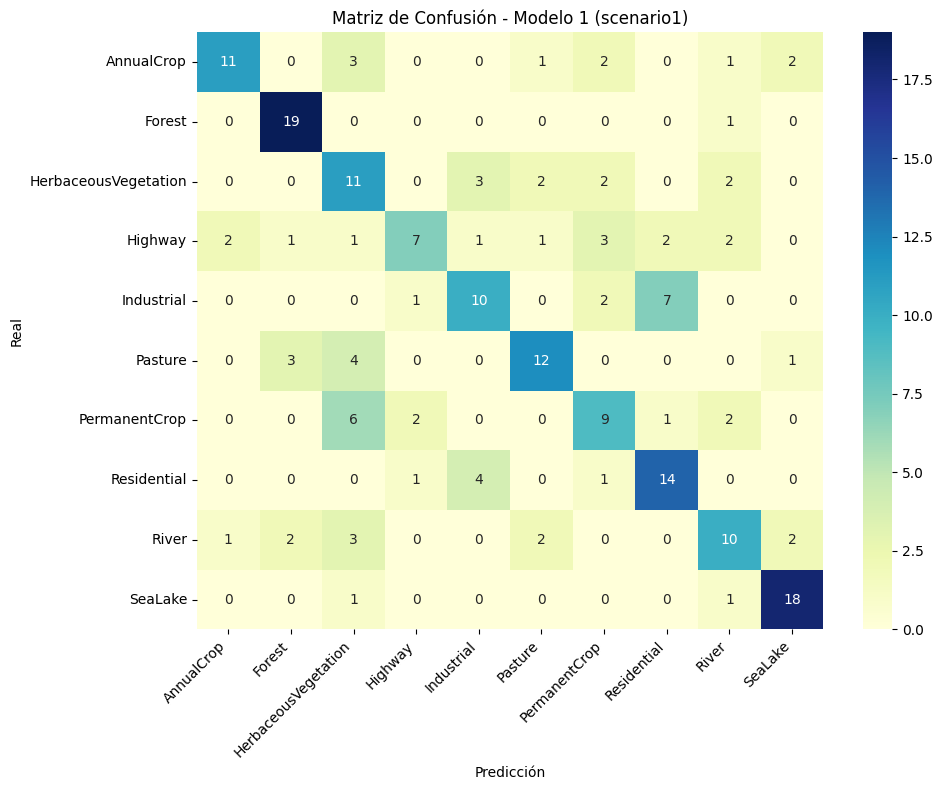


 Classification Report - Modelo 2 (scenario1)
                      precision    recall  f1-score   support

          AnnualCrop       0.78      0.70      0.74        20
              Forest       0.95      0.95      0.95        20
HerbaceousVegetation       0.53      0.40      0.46        20
             Highway       0.48      0.50      0.49        20
          Industrial       0.60      0.90      0.72        20
             Pasture       0.62      0.75      0.68        20
       PermanentCrop       0.45      0.50      0.48        20
         Residential       1.00      0.70      0.82        20
               River       0.61      0.55      0.58        20
             SeaLake       0.89      0.80      0.84        20

            accuracy                           0.68       200
           macro avg       0.69      0.67      0.68       200
        weighted avg       0.69      0.68      0.68       200

ROC-AUC (OVR): 0.9330


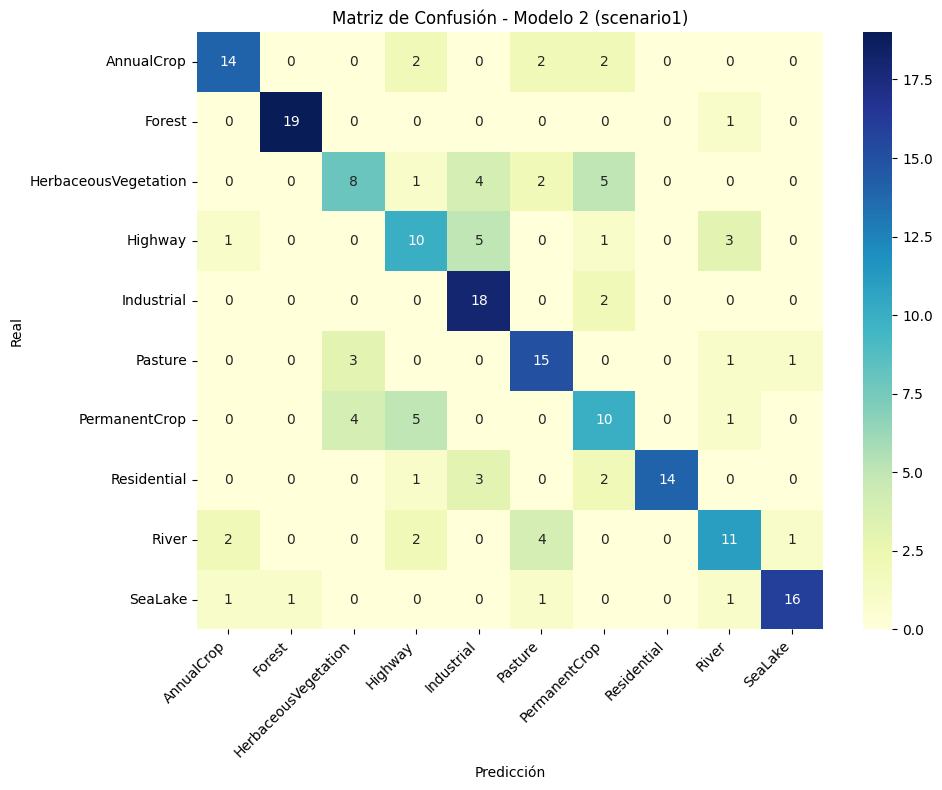


 Classification Report - Modelo 3 (scenario1)
                      precision    recall  f1-score   support

          AnnualCrop       0.83      0.75      0.79        20
              Forest       0.75      0.90      0.82        20
HerbaceousVegetation       0.33      0.45      0.38        20
             Highway       0.62      0.40      0.48        20
          Industrial       0.68      0.85      0.76        20
             Pasture       0.83      0.50      0.62        20
       PermanentCrop       0.38      0.50      0.43        20
         Residential       0.89      0.80      0.84        20
               River       0.65      0.65      0.65        20
             SeaLake       0.88      0.75      0.81        20

            accuracy                           0.66       200
           macro avg       0.69      0.66      0.66       200
        weighted avg       0.69      0.66      0.66       200

ROC-AUC (OVR): 0.9390


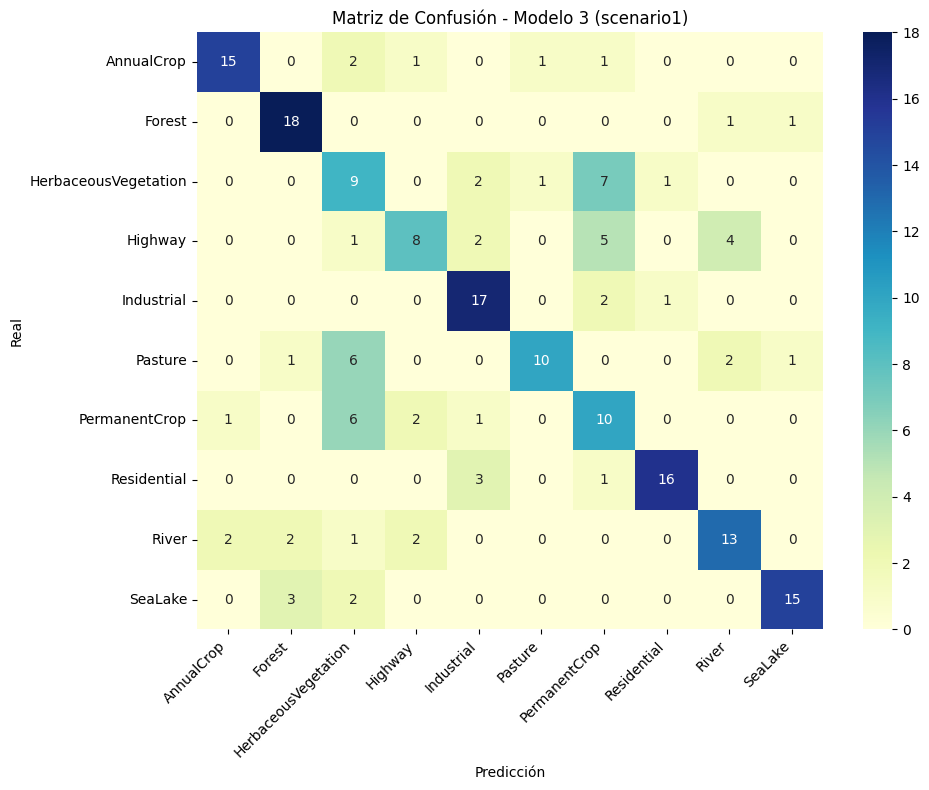


 Classification Report - Modelo 1 (scenario2)
                      precision    recall  f1-score   support

          AnnualCrop       0.79      0.60      0.68       100
              Forest       0.77      0.77      0.77       100
HerbaceousVegetation       0.50      0.65      0.57       100
             Highway       0.60      0.34      0.43       100
          Industrial       0.79      0.84      0.82       100
             Pasture       0.64      0.81      0.71       100
       PermanentCrop       0.48      0.44      0.46       100
         Residential       0.73      0.82      0.77       100
               River       0.60      0.64      0.62       100
             SeaLake       0.91      0.85      0.88       100

            accuracy                           0.68      1000
           macro avg       0.68      0.68      0.67      1000
        weighted avg       0.68      0.68      0.67      1000

ROC-AUC (OVR): 0.9509


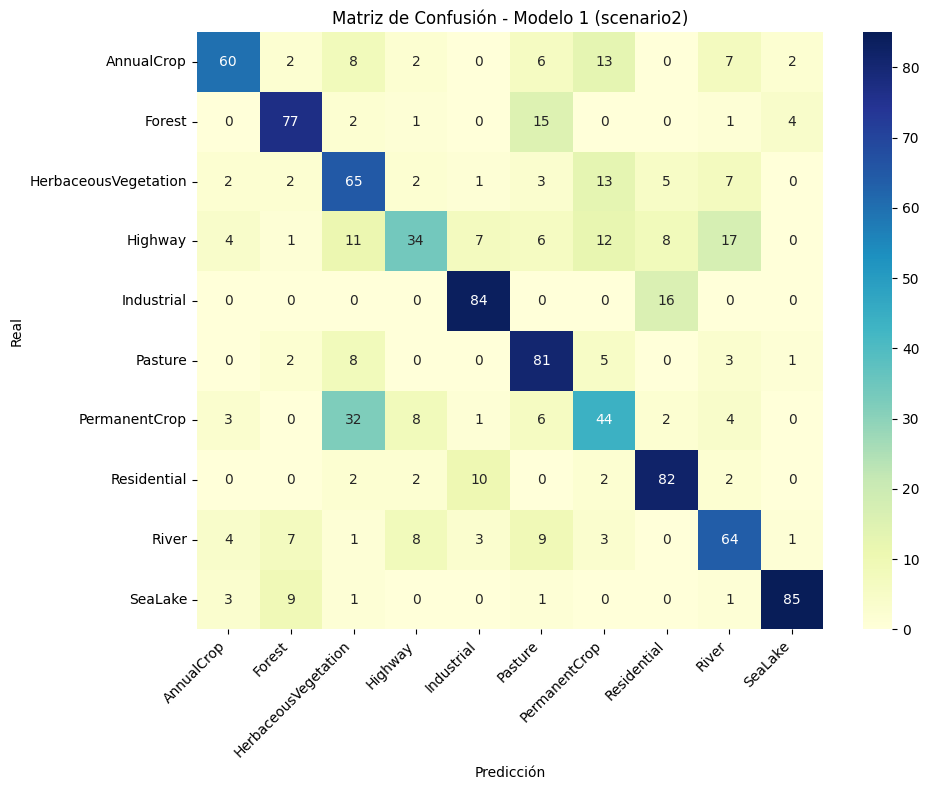


 Classification Report - Modelo 2 (scenario2)
                      precision    recall  f1-score   support

          AnnualCrop       0.85      0.75      0.80       100
              Forest       0.82      0.82      0.82       100
HerbaceousVegetation       0.69      0.64      0.66       100
             Highway       0.52      0.57      0.55       100
          Industrial       0.79      0.94      0.86       100
             Pasture       0.74      0.81      0.77       100
       PermanentCrop       0.64      0.69      0.67       100
         Residential       0.88      0.89      0.89       100
               River       0.68      0.56      0.62       100
             SeaLake       0.96      0.87      0.91       100

            accuracy                           0.75      1000
           macro avg       0.76      0.75      0.75      1000
        weighted avg       0.76      0.75      0.75      1000

ROC-AUC (OVR): 0.9634


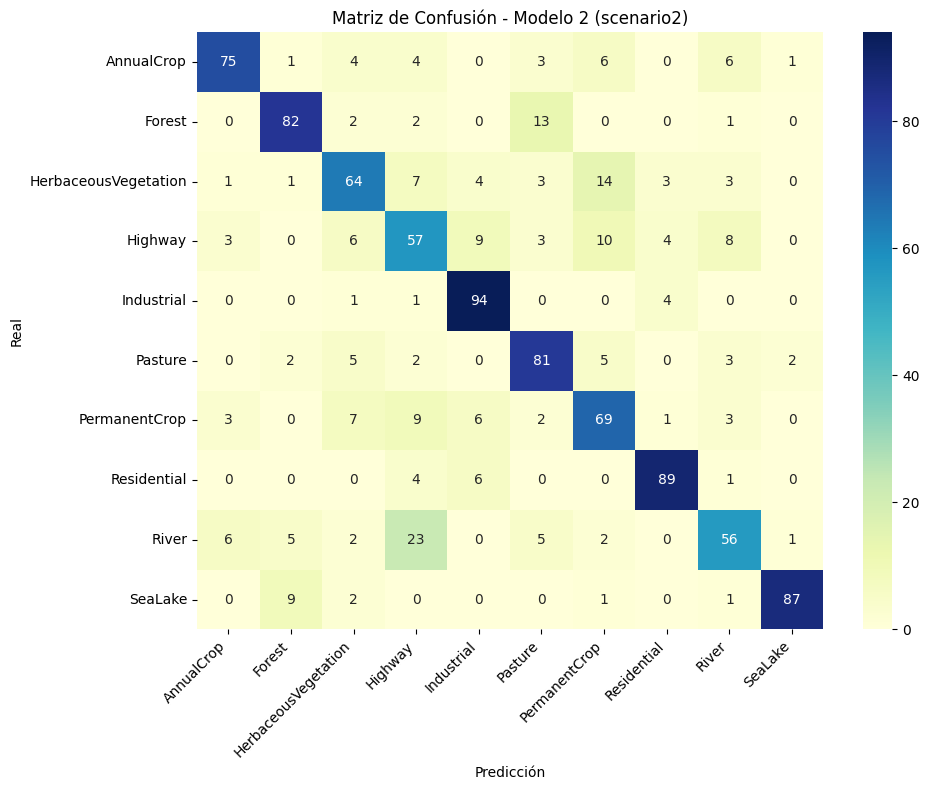


 Classification Report - Modelo 3 (scenario2)
                      precision    recall  f1-score   support

          AnnualCrop       0.87      0.79      0.83       100
              Forest       0.78      0.85      0.81       100
HerbaceousVegetation       0.60      0.67      0.63       100
             Highway       0.70      0.56      0.62       100
          Industrial       0.96      0.89      0.92       100
             Pasture       0.78      0.81      0.79       100
       PermanentCrop       0.61      0.73      0.67       100
         Residential       0.87      0.94      0.90       100
               River       0.76      0.67      0.71       100
             SeaLake       0.90      0.86      0.88       100

            accuracy                           0.78      1000
           macro avg       0.78      0.78      0.78      1000
        weighted avg       0.78      0.78      0.78      1000

ROC-AUC (OVR): 0.9707


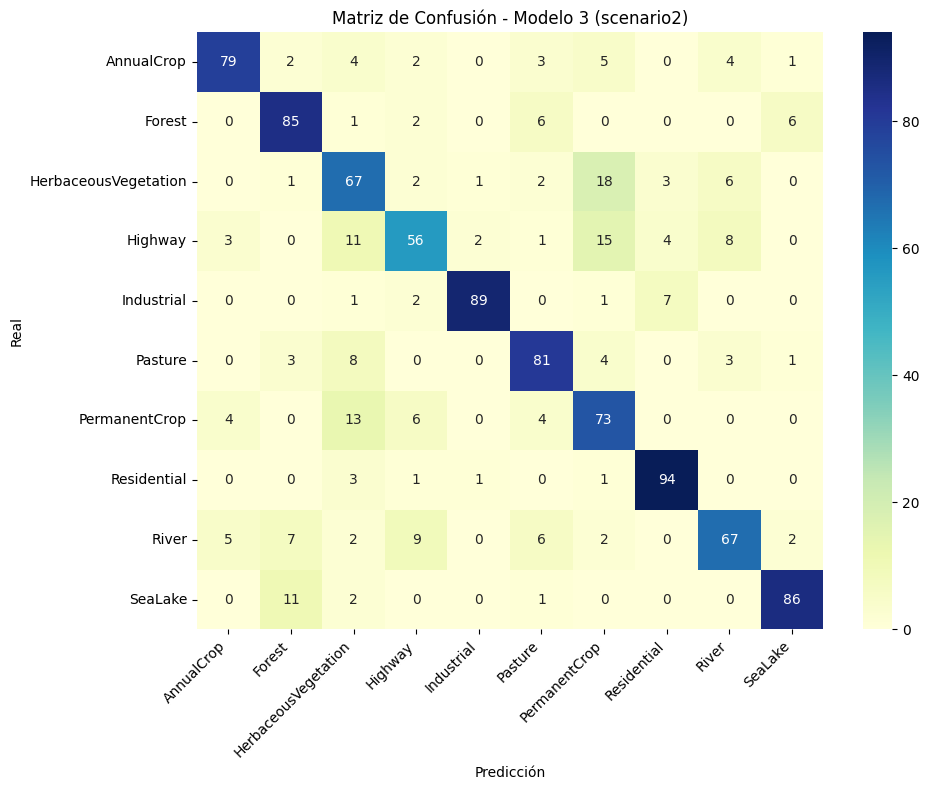

In [ ]:
# Evalúo todos los modelos en ambos escenarios usando los generadores de test
test_generators = {
    "scenario1": test_gen_1,
    "scenario2": test_gen_2
}

for scenario_key, test_gen in test_generators.items():
    for model_name, (model, _) in history_dict[scenario_key].items():
        evaluate_model(model, test_gen, scenario_key, model_name)

## 6 - Gráficas de entrenamiento y validación

### 6.1 - Curvas de aprendizaje por escenario (precisión)

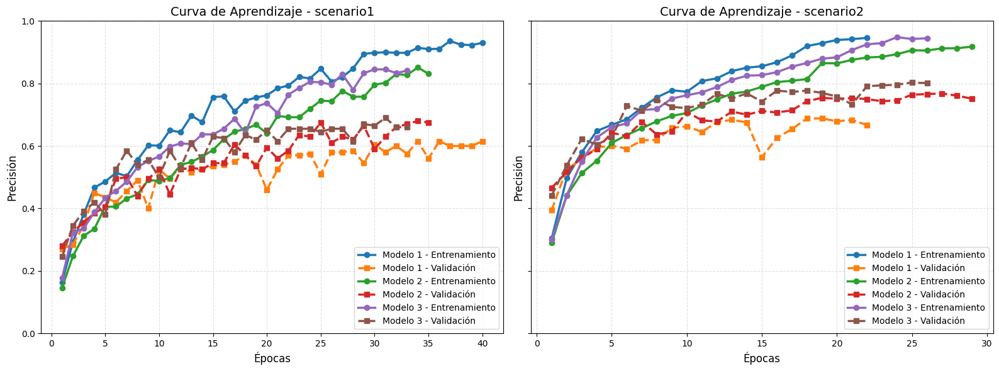

In [ ]:
# Curvas de aprendizaje por escenario (accuracy en entrenamiento y validación)
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

for idx, (scenario, models) in enumerate(history_dict.items()):
    ax = axes[idx]
    for model_name, (_, history) in models.items():
        epochs = range(1, len(history.history["accuracy"]) + 1)

        # Accuracy en entrenamiento
        ax.plot(epochs, history.history["accuracy"], marker="o", linewidth=2.5, label=f"{model_name} - Entrenamiento")

        # Accuracy en validación
        ax.plot(epochs, history.history["val_accuracy"], marker="s", linestyle="--", linewidth=2.5, label=f"{model_name} - Validación")

    ax.set_facecolor("white")
    ax.set_title(f"Curva de Aprendizaje - {scenario}", fontsize=14)
    ax.set_xlabel("Épocas", fontsize=12)
    ax.set_ylabel("Precisión", fontsize=12)
    ax.set_ylim(0, 1)
    ax.legend(loc="lower right")
    ax.grid(True, linestyle="--", alpha=0.4)
    ax.tick_params(axis='both', which='both', labelsize=10)

plt.tight_layout()
plt.show()

### 6.2 - Curvas de aprendizaje por modelo (precisión)

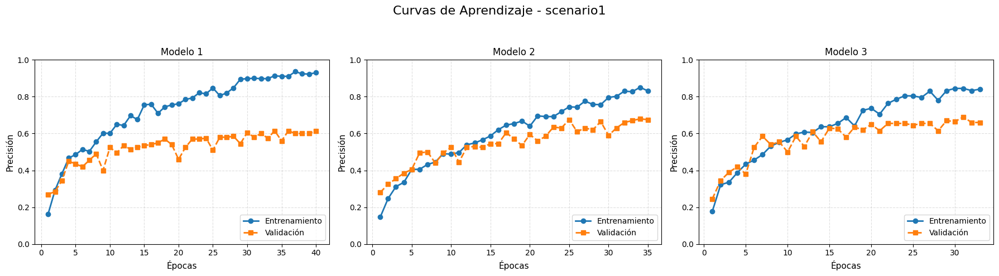

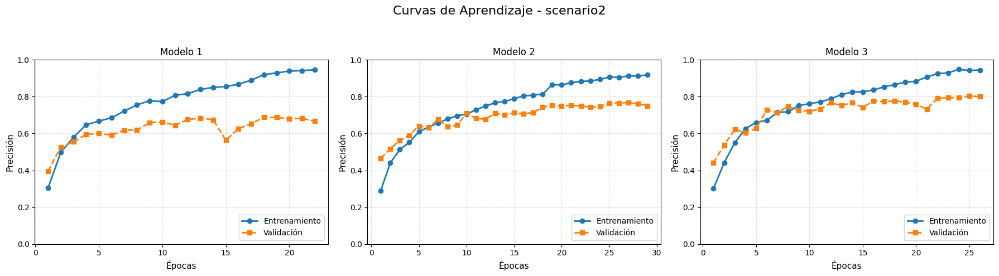

In [ ]:
# Curvas de aprendizaje (accuracy) por modelo
for scenario, models in history_dict.items():
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    fig.suptitle(f"Curvas de Aprendizaje - {scenario}", fontsize=16)

    for idx, (model_name, (_, history)) in enumerate(models.items()):
        ax = axes[idx]
        epochs = range(1, len(history.history["accuracy"]) + 1)
        acc = history.history["accuracy"]
        val_acc = history.history["val_accuracy"]

        # Precisión en entrenamiento
        ax.plot(epochs, acc, marker='o', label="Entrenamiento", linewidth=2)

        # Precisión en validación
        ax.plot(epochs, val_acc, marker='s', linestyle='--', label="Validación", linewidth=2)

        ax.set_title(model_name)
        ax.set_xlabel("Épocas", fontsize=11)
        ax.set_ylabel("Precisión", fontsize=11)
        ax.set_ylim(0, 1)
        ax.grid(True, linestyle="--", alpha=0.4)
        ax.legend(loc="lower right")

    plt.tight_layout(rect=[0, 0, 1, 0.93])
    plt.show()

### 6.3 - Curvas de pérdida por modelo (loss)



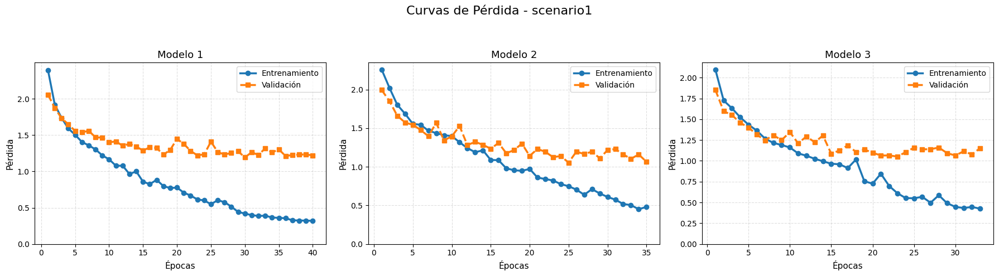

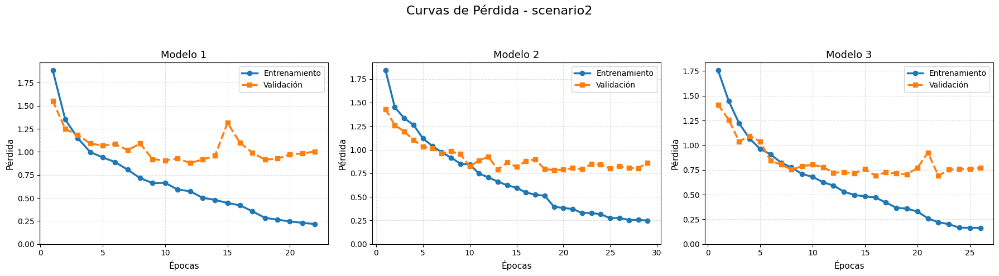

In [ ]:
# Curvas de pérdida (loss) por modelo
for scenario, models in history_dict.items():
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    fig.suptitle(f"Curvas de Pérdida - {scenario}", fontsize=16)

    for idx, (model_name, (_, history)) in enumerate(models.items()):
        ax = axes[idx]
        epochs = range(1, len(history.history["loss"]) + 1)

        # Pérdida en entrenamiento
        ax.plot(epochs, history.history["loss"], marker="o", linewidth=2.5, label="Entrenamiento")

        # Pérdida en validación
        ax.plot(epochs, history.history["val_loss"], marker="s", linestyle="--", linewidth=2.5, label="Validación")

        ax.set_title(model_name, fontsize=13)
        ax.set_xlabel("Épocas", fontsize=11)
        ax.set_ylabel("Pérdida", fontsize=11)
        ax.set_ylim(bottom=0)
        ax.grid(True, linestyle="--", alpha=0.4)
        ax.legend(loc="upper right")

    plt.tight_layout(rect=[0, 0, 1, 0.92])
    plt.show()

# Ejercicio C - Simulación de redes con TensorFlow Playground

[TensorFlow Playground](https://playground.tensorflow.org/) es un simulador de redes neuronales creado por el equipo de TensorFlow. En este ejercicio, debéis entrenar varios clasificadores y ajustar la arquitectura del modelo y sus hiperparámetros para comprender cómo funcionan las redes neuronales y su impacto en el aprendizaje.

### **Tareas a realizar**
A lo largo del ejercicio, se os pide que realicéis las siguientes pruebas y aportéis capturas de pantalla de los resultados obtenidos, junto con breves comentarios descriptivos:

1. **Patrones que aprende una red neuronal:**
   - Entrenad la red predeterminada y observad cómo las neuronas de la primera capa oculta aprenden patrones simples, mientras que la segunda capa oculta combina estos en patrones más complejos.
2. **Funciones de activación:**
   - Sustituid la función de activación `tanh` por `ReLU` y entrenad la red nuevamente. Observad cómo el modelo encuentra una solución más rápidamente, pero con límites de decisión lineales.
3. **Riesgo de mínimos locales:**
   - Modificad la red para tener una sola capa oculta con tres neuronas y entrenadla varias veces. Observad cómo el entrenamiento varía en tiempo y puede atascarse en mínimos locales.
4. **Impacto de redes demasiado pequeñas:**
   - Reducid el número de neuronas a dos y entrenad la red varias veces. Analizad cómo el modelo no encuentra una solución adecuada por falta de capacidad de aprendizaje.
5. **Mejora con redes algo más grandes:**
   - Ajustad la red a ocho neuronas y entrenadla. Observad que la red se vuelve más estable y menos propensa a atascarse en mínimos locales.
6. **Desvanecimiento del gradiente en redes profundas:**
   - Usad el dataset *spiral* y configurad una red con cuatro capas ocultas de ocho neuronas cada una. Observad cómo el entrenamiento se ralentiza y cómo las neuronas en capas más profundas evolucionan más lentamente.
7. **Exploración propia:**
   - Diseñad tres arquitecturas de redes neuronales diferentes sobre uno de los conjuntos de datos disponibles y comparad los resultados obtenidos.

Este ejercicio os permitirá familiarizaros con los principales elementos del diseño, entrenamiento y validación de una red neuronal artificial.

In [17]:
# Monto Google Drive
from google.colab import drive
print("Conectando con Google Drive...")
drive.mount('/content/drive')

Conectando con Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [18]:
# Librerías necesarias para plotear las capturas en el notebook
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

## 1 - Patrones que aprende una red neuronal

In [ ]:
# Configuración utilizada:
# 	-	Dataset: Circle
# 	-	Learning Rate: 0.03
# 	-	Activación: tanh
# 	-	Arquitectura: 2 capas ocultas con 4 y 2 respectivamente
# 	-	Regularización: None
# 	-	Epochs: Hasta que se estabilizó la curva de loss/test

In [ ]:
# En la primera capa oculta, las neuronas aprenden patrones básicos y lineales, como divisiones verticales, horizontales o diagonales.
# En la segunda capa, las neuronas combinan esas salidas para generar zonas más complejas y curvas.
# Esto refleja cómo las capas ocultas trabajan jerárquicamente para aprender representaciones progresivamente más abstractas.

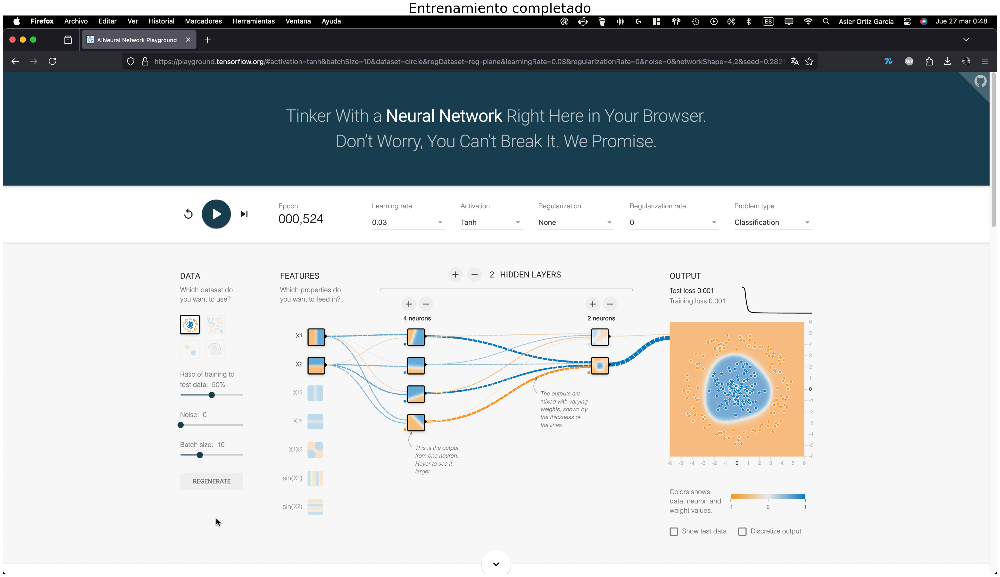

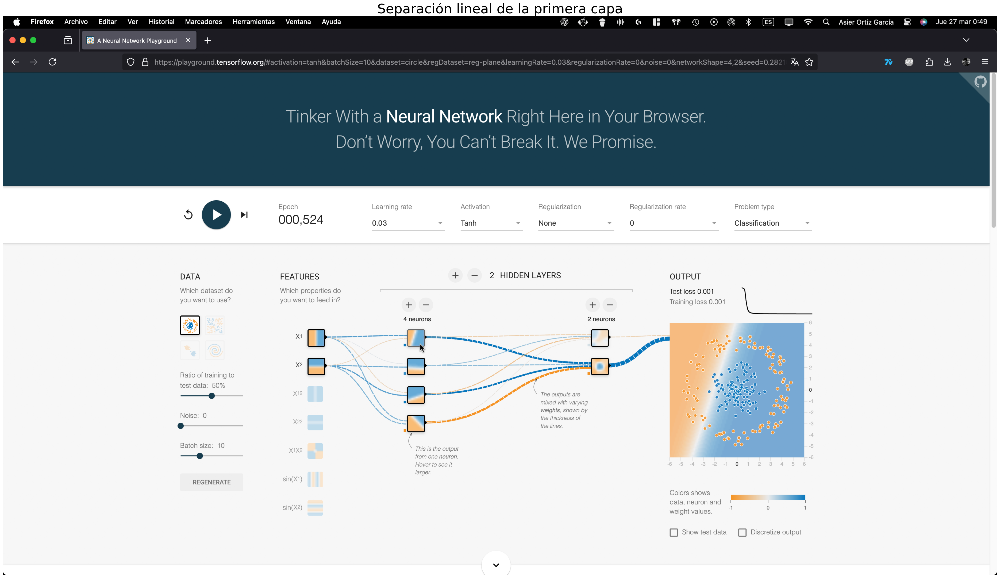

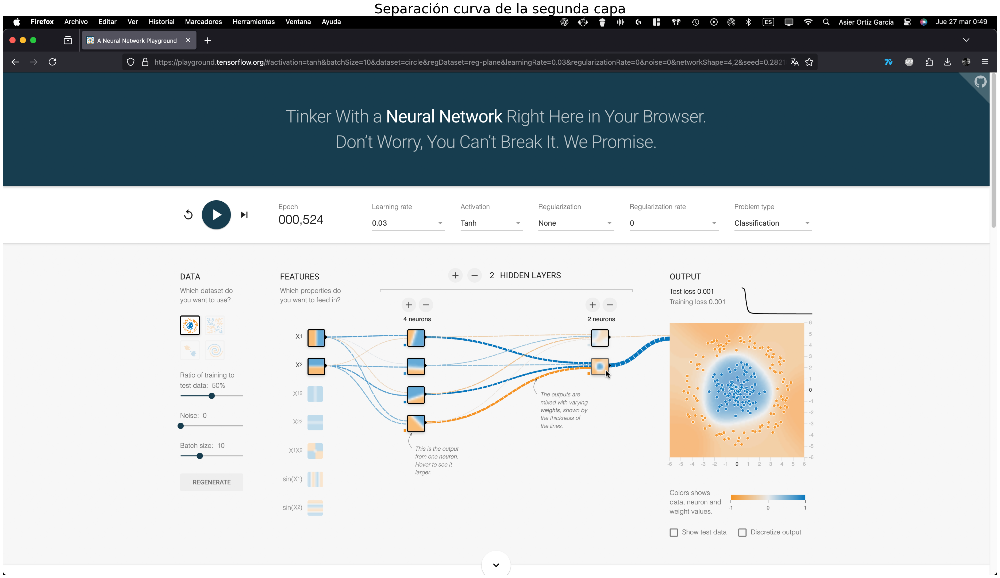

In [ ]:
# Capturas:

# Imágenes y títulos
images = [
    ("1-1.png", "Entrenamiento completado"),
    ("1-2.png", "Separación lineal de la primera capa"),
    ("1-3.png", "Separación curva de la segunda capa"),
]

# Ruta base en Drive
base_path = "/content/drive/MyDrive/TF_Playground_Screenshots/"

# Muestro las imágenes
for file_name, title in images:
    img = mpimg.imread(base_path + file_name)
    plt.figure(figsize=(48, 32))
    plt.imshow(img)
    plt.title(title, fontsize=36)
    plt.axis('off')
    plt.show()

## 2 - Funciones de activación

In [ ]:
# Configuración utilizada:
# 	-	Dataset: Circle
# 	-	Learning Rate: 0.03
# 	-	Activación: ReLU
# 	-	Arquitectura: 2 capas ocultas con 4 y 2 neuronas respectivamente
# 	-	Regularización: None
# 	-	Epochs: Hasta que se estabilizó la curva de loss/test

In [ ]:
# Al cambiar la función de activación de tanh a ReLU, se observa que la red aprende más rápidamente en las primeras épocas.
# Sin embargo, las fronteras de decisión tienden a ser más lineales y angulosas, lo que limita la capacidad del modelo para aprender formas curvas como las del dataset circular.
# En comparación, tanh produce fronteras más suaves, lo que puede ser ventajoso en problemas con estructuras no lineales.

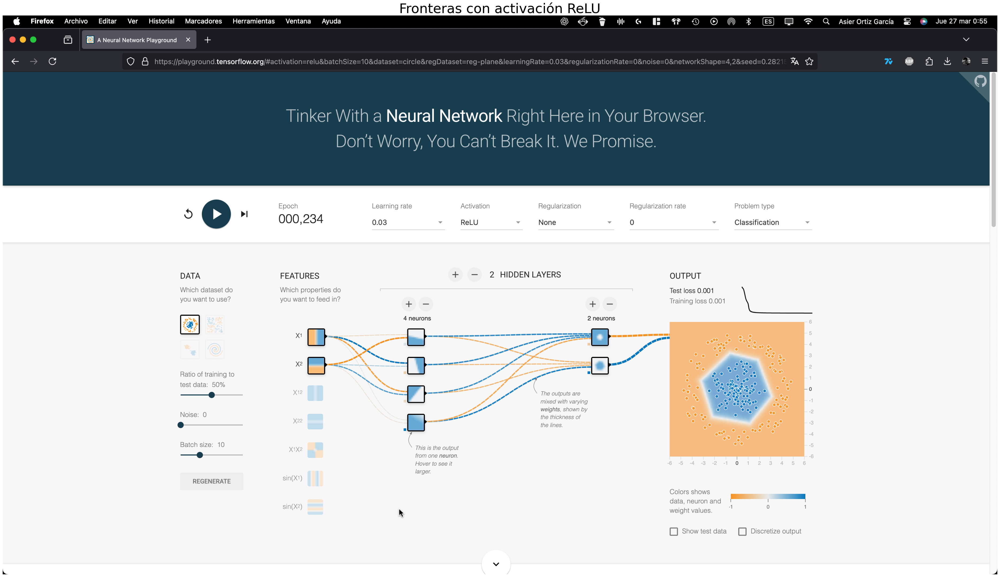

In [ ]:
# Capturas:

# Ruta base en Drive
img_path = "/content/drive/MyDrive/TF_Playground_Screenshots/2-1.png"

# Muestro la imagen
img = mpimg.imread(img_path)
plt.figure(figsize=(48, 32))
plt.imshow(img)
plt.title("Fronteras con activación ReLU", fontsize=36)
plt.axis('off')
plt.show()

## 3 - Riesgo de mínimos locales

In [ ]:
# Configuración utilizada:
#	-	Dataset: Circle
#	-	Learning Rate: 0.03
#	-	Activación: tanh
#	-	Arquitectura: 1 capa oculta con 3 neuronas
#	-	Regularización: None
#	-	Epochs: Hasta que se estabilizó la curva de loss/test (varias ejecuciones)

In [ ]:
# Al reducir la red a solo una capa con tres neuronas, se hace evidente que el modelo no siempre encuentra una buena solución.
# En algunas ejecuciones, el modelo logra separar las clases correctamente pero en otras se queda atascado, mostrando fronteras de decisión incorrectas.

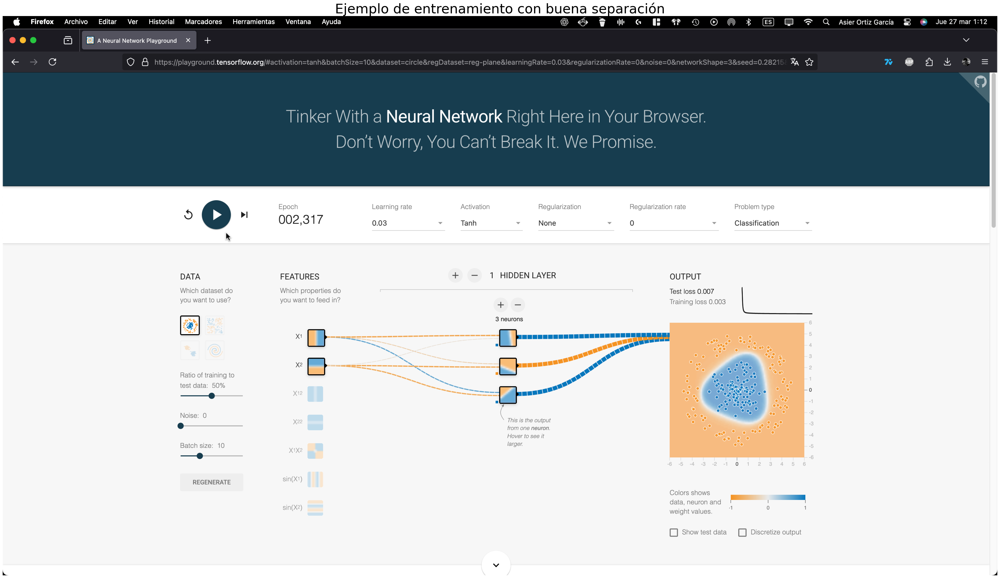

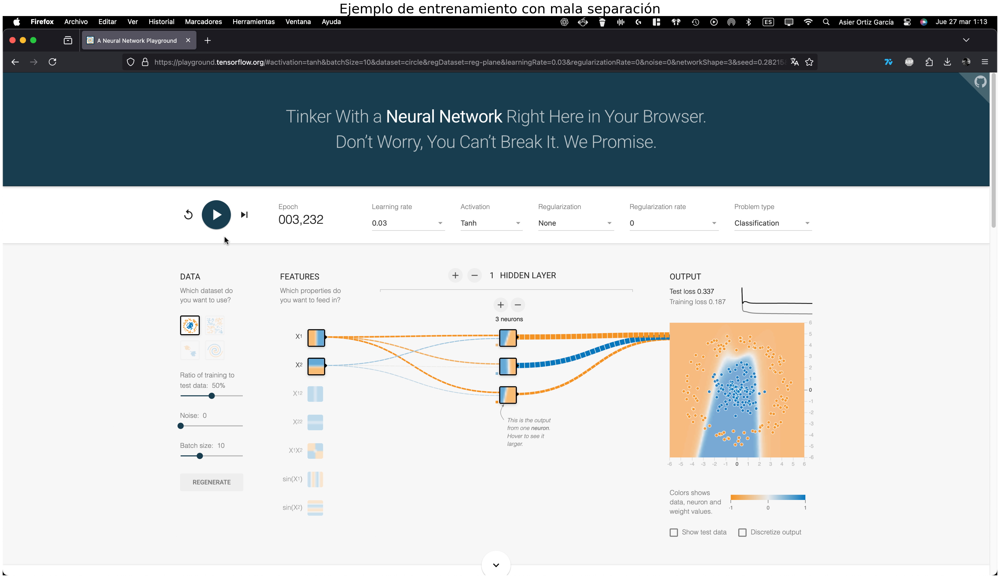

In [ ]:
# Capturas:

# Imágenes y títulos
images = [
    ("3-1.png", "Ejemplo de entrenamiento con buena separación"),
    ("3-2.png", "Ejemplo de entrenamiento con mala separación"),
]

# Ruta base en Drive
base_path = "/content/drive/MyDrive/TF_Playground_Screenshots/"

# Muestro las imágenes
for file_name, title in images:
    img = mpimg.imread(base_path + file_name)
    plt.figure(figsize=(48, 32))
    plt.imshow(img)
    plt.title(title, fontsize=36)
    plt.axis('off')
    plt.show()

## 4 - Impacto de redes demasiado pequeñas

In [ ]:
# Configuración utilizada:
#	-	Dataset: Circle
#	-	Learning Rate: 0.03
#	-	Activación: tanh
#	-	Arquitectura: 1 capa oculta con 2 neuronas
#	-	Regularización: None
#	-	Epochs: Hasta que se estabilizó la curva de loss/test (Varias pruebas)

In [ ]:
# Con solo 2 neuronas en una capa oculta, la red no tiene suficiente capacidad para aprender la estructura no lineal del dataset.
# Se observa que no logra separar correctamente las clases aunque se entrene varias veces.
# Este caso demuestra que una red demasiado pequeña es incapaz de aprender patrones complejos (underfitting)

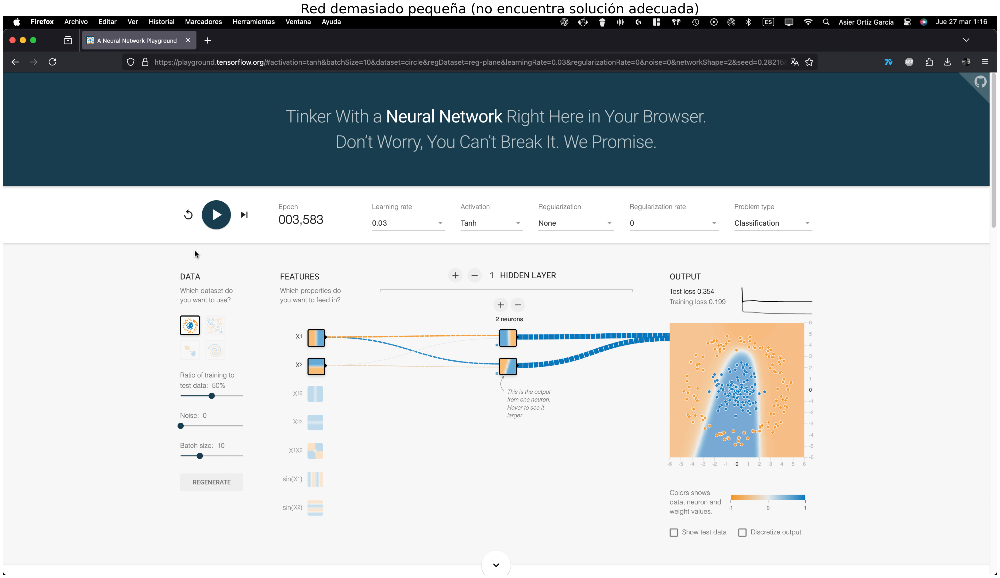

In [ ]:
# Capturas:

# Ruta base en Drive
img_path = "/content/drive/MyDrive/TF_Playground_Screenshots/4-1.png"

# Muestro la imagen
img = mpimg.imread(img_path)
plt.figure(figsize=(48, 32))
plt.imshow(img)
plt.title("Red demasiado pequeña (no encuentra solución adecuada)", fontsize=36)
plt.axis('off')
plt.show()

## 5 - Mejora con redes algo más grandes

In [ ]:
# Configuración utilizada:
#	-	Dataset: Circle
#	-	Learning Rate: 0.03
#	-	Activación: tanh
#	-	Arquitectura: 1 capa oculta con 8 neuronas
#	-	Regularización: None
# -	Epochs: Hasta que se estabilizó la curva de loss/test

In [ ]:
# Al aumentar el número de neuronas a 8 en una única capa oculta, la red es mucho más capaz de aprender la estructura no lineal del dataset.
# Además el entrenamiento no se atasca, lo que indica que la red tiene suficiente capacidad para evitar mínimos locales.

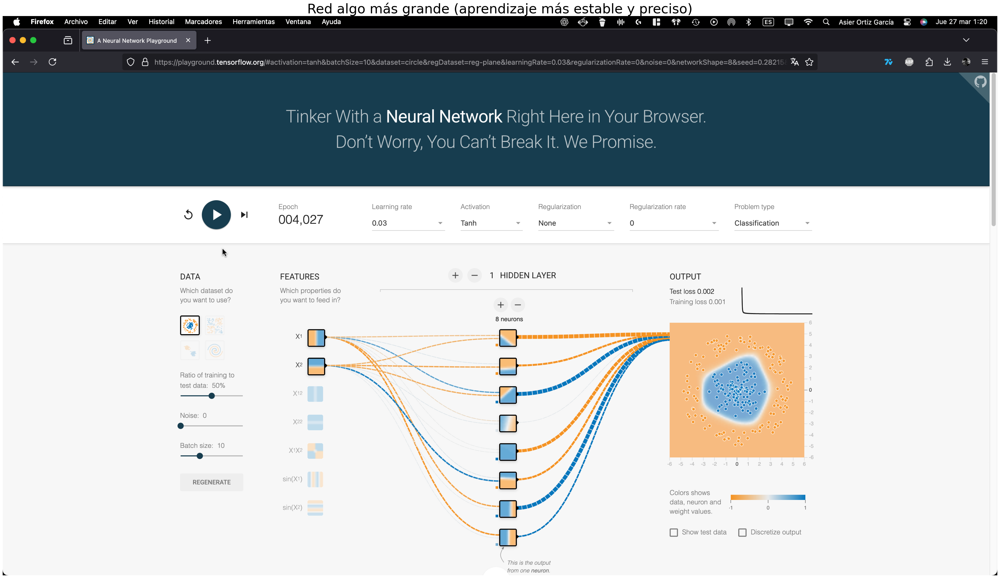

In [ ]:
# Capturas:

# Ruta base en Drive
img_path = "/content/drive/MyDrive/TF_Playground_Screenshots/5-1.png"

# Muestro la imagen
img = mpimg.imread(img_path)
plt.figure(figsize=(48, 32))
plt.imshow(img)
plt.title("Red algo más grande (aprendizaje más estable y preciso)", fontsize=36)
plt.axis('off')
plt.show()

## 6 - Desvanecimiento del gradiente en redes profundas

In [ ]:
# Configuración utilizada:
#	-	Dataset: Spiral
#	-	Learning Rate: 0.01
#	-	Activación: tanh
#	-	Arquitectura: 4 capas ocultas, cada una con 8 neuronas
#	-	Regularización: None
#	-	Epochs: Hasta que se estabilizó la curva de loss/test

In [ ]:
# Las primeras capas muestran bastante actividad en comparación con las siguientes.
# Parece que el efecto del desvanecimiento del gradiente hace que las capas profundas tarden más en aprender.

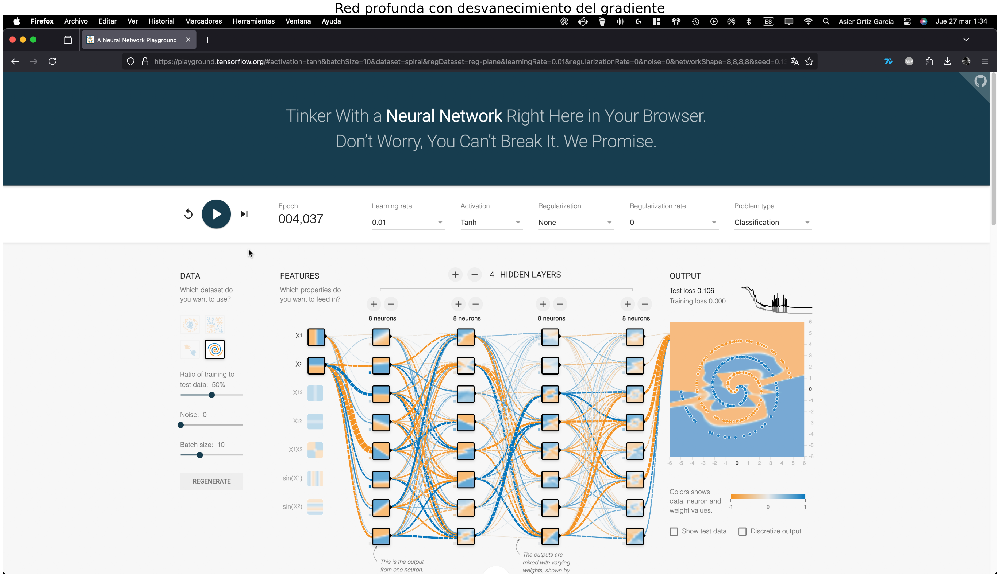

In [ ]:
# Capturas:

# Ruta base en Drive
img_path = "/content/drive/MyDrive/TF_Playground_Screenshots/6-1.png"

# Muestro la imagen
img = mpimg.imread(img_path)
plt.figure(figsize=(48, 32))
plt.imshow(img)
plt.title("Red profunda con desvanecimiento del gradiente", fontsize=36)
plt.axis('off')
plt.show()

## 7 - Exploración propia

### 7.1 - Comparación de funciones de activación

In [ ]:
# Configuración utilizada:
#	-	Dataset: Gaussian
#	-	Learning Rate: 0.03
#	-	Activación: [tanh, ReLU, sigmoid]
#	-	Arquitectura: 2 capas ocultas con 4 neuronas cada una
#	-	Regularización: None
#	-	Epochs: Hasta que se estabilizó la curva de loss/test

In [ ]:
# Con tanh y sigmoid, las fronteras de decisión son más suaves, aunque el aprendizaje es más lento.
# ReLU aprende más rápido pero con fronteras más rígidas.
# Esto muestra cómo la función de activación afecta tanto a la forma de la frontera como a la eficiencia del entrenamiento.

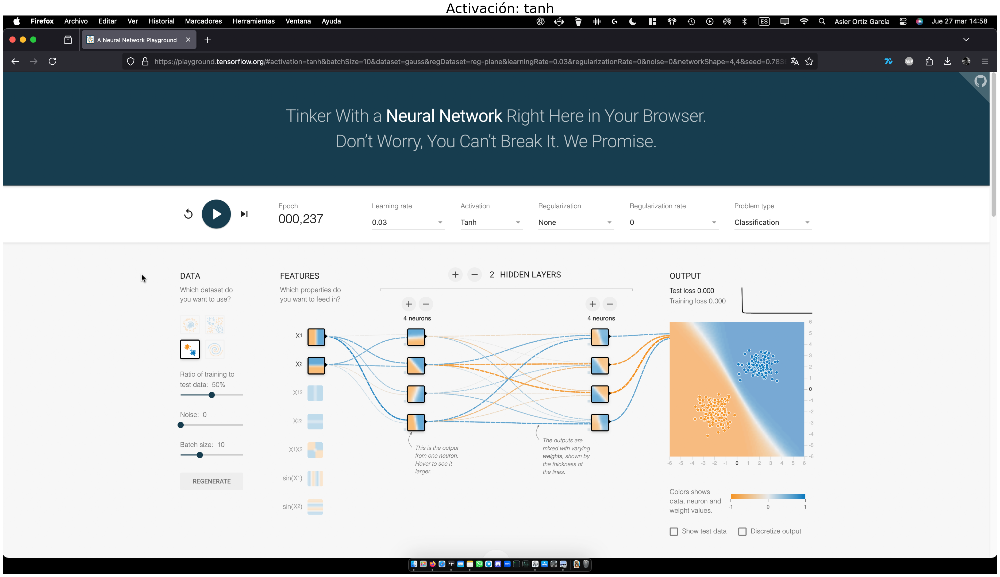

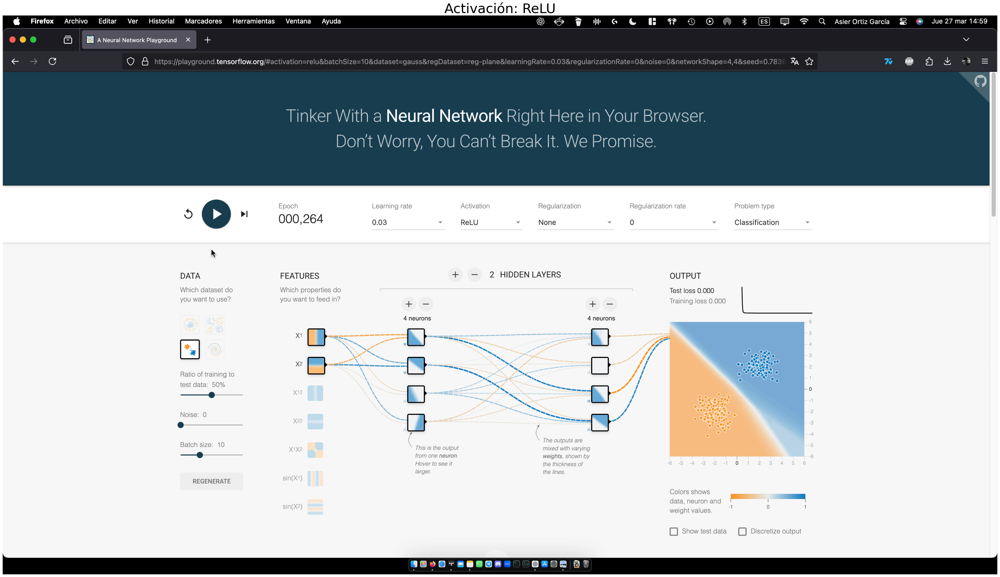

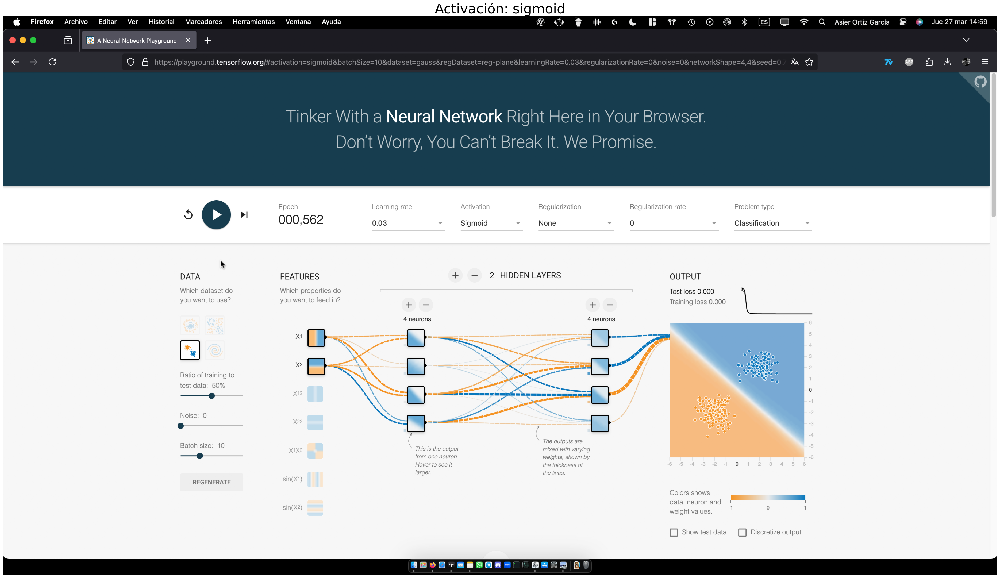

In [ ]:
# Capturas:

# Imágenes y títulos
images = [
    ("7-1-1.png", "Activación: tanh"),
    ("7-1-2.png", "Activación: ReLU"),
    ("7-1-3.png", "Activación: sigmoid"),
]

# Ruta base en Drive
base_path = "/content/drive/MyDrive/TF_Playground_Screenshots/"

# Muestro las imágenes
for file_name, title in images:
    img = mpimg.imread(base_path + file_name)
    plt.figure(figsize=(48, 32))
    plt.imshow(img)
    plt.title(title, fontsize=36)
    plt.axis('off')
    plt.show()

### 7.2 - Añadir ruido al dataset y ver cómo responde la red

In [ ]:
# Configuración utilizada:
#	-	Dataset: Circle
#	-	Learning Rate: 0.03
#	-	Activación: tanh
#	-	Arquitectura: 2 capas ocultas con 6 neuronas cada una
#	-	Ruido: [0, 50]
#	-	Regularización: None
#	-	Epochs: Hasta que se estabilizó la curva de loss/test

In [ ]:
# En esta prueba he comparado el comportamiento de la red neuronal al introducir distintos niveles de ruido en los datos de entrenamiento.
#	Con ruido 0, el modelo aprende una frontera de decisión más precisa y suave.
# Con ruido 50, la red sigue capturando la forma general, pero ya no se adapta correctamente a todos los puntos.

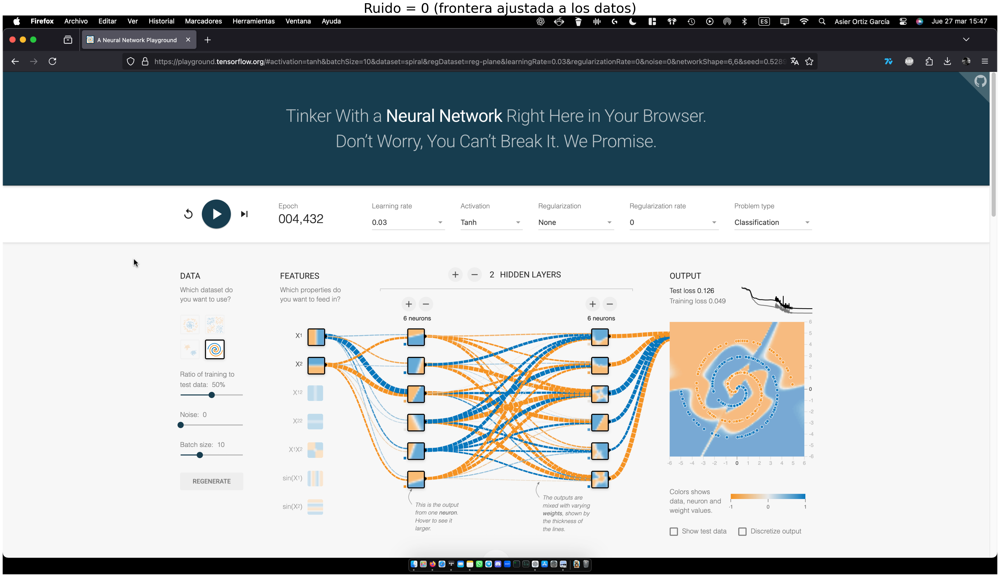

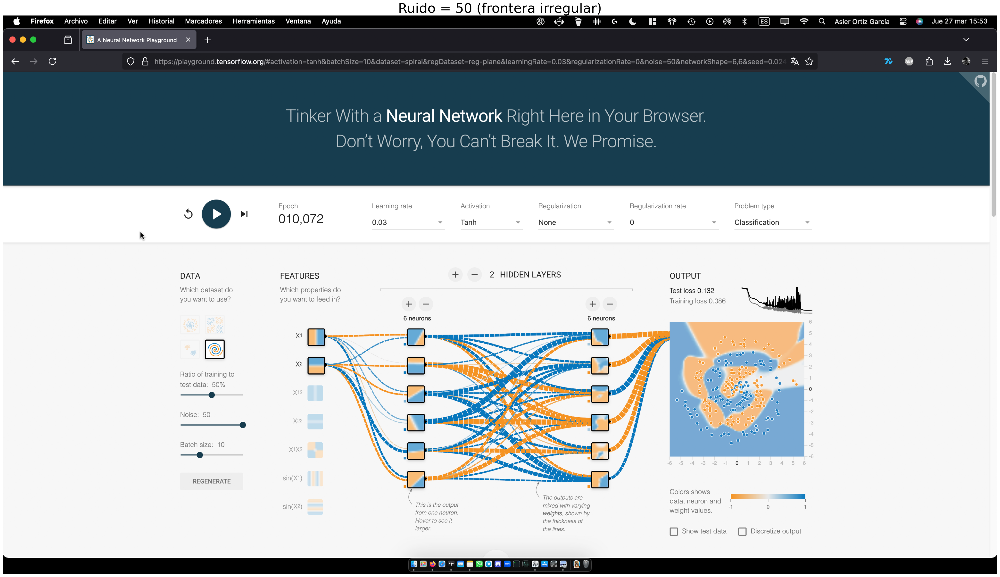

In [19]:
# Capturas:

# Imágenes y títulos
images = [
    ("7-2-1.png", "Ruido = 0 (frontera ajustada a los datos)"),
    ("7-2-2.png", "Ruido = 50 (frontera irregular)"),
]

# Ruta base en Drive
base_path = "/content/drive/MyDrive/TF_Playground_Screenshots/"

# Muestro las imágenes
for file_name, title in images:
    img = mpimg.imread(base_path + file_name)
    plt.figure(figsize=(48, 32))
    plt.imshow(img)
    plt.title(title, fontsize=36)
    plt.axis('off')
    plt.show()

### 7.3 - Prueba con regularización L2

In [ ]:
# Configuración utilizada:
#	-	Dataset: Circle
#	-	Learning Rate: 0.03
#	-	Activación: tanh
#	-	Features: [X1, X2]
#	-	Arquitectura: 2 capas ocultas con 4 neuronas cada una
#	-	Ruido: 20
#	-	Regularización: [None, L2]
#	-	Tasa de regularización: 0.1
#	-	Epochs: Hasta que se estabilizó la curva de loss/test

In [ ]:
# En este experimento he subido el ruido a 20 para simular datos con bastantes outliers en el dataset Circle.
#	Sin regularización, la red intenta adaptarse al ruido y genera una frontera muy irregular.
#	Con regularización L2, la red ignora parte del ruido y la frontera queda mucho más suave.

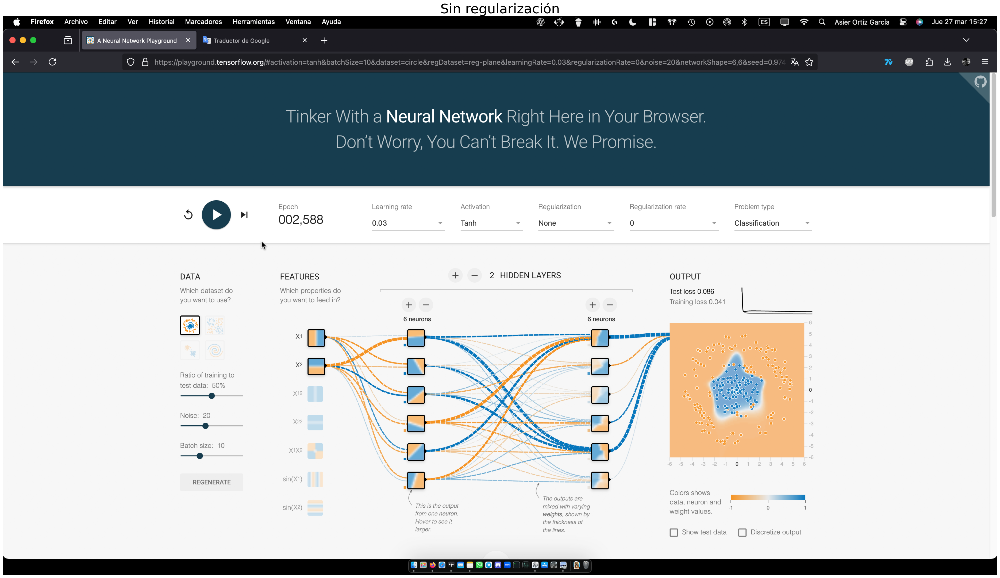

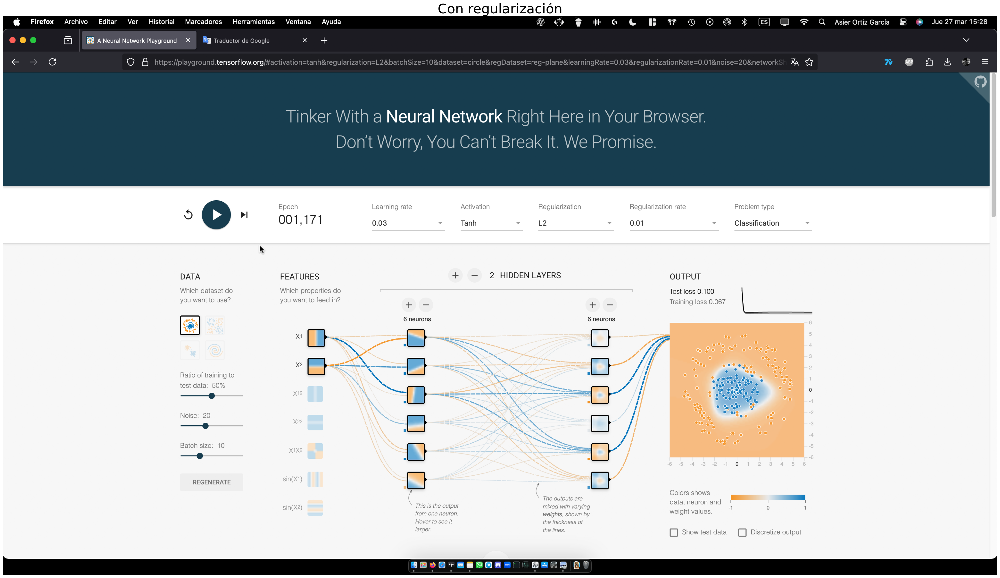

In [ ]:
# Capturas:

# Imágenes y títulos
images = [
    ("7-3-1.png", "Sin regularización"),
    ("7-3-2.png", "Con regularización"),
]

# Ruta base en Drive
base_path = "/content/drive/MyDrive/TF_Playground_Screenshots/"

# Muestro las imágenes
for file_name, title in images:
    img = mpimg.imread(base_path + file_name)
    plt.figure(figsize=(48, 32))
    plt.imshow(img)
    plt.title(title, fontsize=36)
    plt.axis('off')
    plt.show()